In [1]:
import turicreate as tc
import matplotlib.pyplot as plt
# 필요한 모듈을 가져온다.

In [2]:
train_data = tc.image_analysis.load_images("snacks/train", with_path=True)
len(train_data)
#train_data를 가져오고 데이터 수 확인

4838

In [3]:
test_data = tc.image_analysis.load_images("snacks/test", with_path=True)
len(test_data)
#test_data를 가져오고 데이터 수 확인

952

In [4]:
import os
train_data["label"] = train_data["path"].apply(lambda path: 
                                               os.path.basename(os.path.split(path)[0]))
test_data["label"] = test_data["path"].apply(lambda path: 
                                             os.path.basename(os.path.split(path)[0]))
train_data["label"].value_counts().print_rows(num_rows=20)
test_data["label"].value_counts().print_rows(num_rows=20)
#이미지 경로에서 label을 추출하고 label 수를 표시한다.

+------------+-------+
|   value    | count |
+------------+-------+
| pineapple  |  260  |
|  hot dog   |  250  |
|   grape    |  250  |
|   apple    |  250  |
|   juice    |  250  |
| ice cream  |  250  |
|   banana   |  250  |
| watermelon |  250  |
|   salad    |  250  |
|   muffin   |  250  |
|  doughnut  |  250  |
|   waffle   |  250  |
|   cookie   |  249  |
|   carrot   |  249  |
|    cake    |  249  |
| strawberry |  249  |
|   candy    |  249  |
|   orange   |  249  |
|  popcorn   |  180  |
|  pretzel   |  154  |
+------------+-------+
[20 rows x 2 columns]

+------------+-------+
|   value    | count |
+------------+-------+
|  doughnut  |   50  |
|  hot dog   |   50  |
|   grape    |   50  |
|   apple    |   50  |
|   juice    |   50  |
| ice cream  |   50  |
|   banana   |   50  |
| watermelon |   50  |
|   salad    |   50  |
|   candy    |   50  |
|   orange   |   50  |
|    cake    |   50  |
|   cookie   |   50  |
|   carrot   |   50  |
|   waffle   |   50  |
| strawberr

/Users/geunseong-gai/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


Run the next cell to train the model.

**OR**

Run the cell **after** the next cell, to load the model from the `starter/notebook` folder.

In [ ]:
# Train the image classifier
model = tc.image_classifier.create(train_data, target="label", 
                                   model="squeezenet_v1.1",
                                   verbose=True, max_iterations=100)

In [5]:
# OR load trained model from starter/notebook folder
model = tc.load_model("MultiSnacks.model")

Downloading base mlmodel

Downloading https://docs-assets.developer.apple.com/coreml/models/SqueezeNet.mlmodel to /var/folders/44/ftc9j45j0j51fjlch9sxln080000gn/T/model_cache/squeezenet_v1.1.mlmodel

Continue with trained or loaded model.

In [6]:
metrics = model.evaluate(test_data)
print("Accuracy: ", metrics["accuracy"])
print("Precision: ", metrics["precision"])
print("Recall: ", metrics["recall"])

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 3.29s        | 6.5%             |

| 128              | 3.79s        | 13.25%           |

| 192              | 4.29s        | 20%              |

| 256              | 4.79s        | 26.5%            |

| 320              | 5.30s        | 33.25%           |

| 640              | 7.87s        | 66.5%            |

| 952              | 10.37s       | 100%             |

+------------------+--------------+------------------+

Accuracy:  0.6470588235294118
Precision:  0.6441343963604581
Recall:  0.6445289115646258


In [7]:
metrics.explore() #시각적으로 확인할 수 있는 창을 띄운다.

Resizing image data... Done.


In [8]:
model.predict(test_data) #예측값을 출력한다.

dtype: str
Rows: 952
['apple', 'apple', 'orange', 'orange', 'orange', 'apple', 'orange', 'apple', 'watermelon', 'apple', 'apple', 'apple', 'strawberry', 'apple', 'apple', 'pineapple', 'strawberry', 'banana', 'apple', 'apple', 'apple', 'apple', 'apple', 'apple', 'apple', 'pineapple', 'orange', 'apple', 'apple', 'apple', 'doughnut', 'apple', 'apple', 'apple', 'orange', 'grape', 'apple', 'orange', 'apple', 'apple', 'apple', 'orange', 'apple', 'strawberry', 'orange', 'apple', 'apple', 'watermelon', 'apple', 'apple', 'banana', 'banana', 'pineapple', 'muffin', 'hot dog', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'hot dog', 'banana', 'banana', 'hot dog', 'banana', 'muffin', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'juice', 'watermelon', 'hot dog', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'watermelon', 'banana', 'banana', 'cookie', 'banana', 'orange'

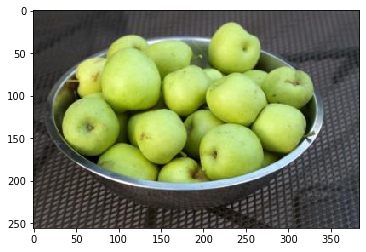

In [9]:
plt.imshow(test_data[1]["image"].pixel_data) #해당 이미지 출력

In [10]:
output = model.classify(test_data) # 각 이미지가 예측한 범주와 확률을 가져온다.
output

class,probability
apple,0.6897392993102849
apple,0.5664566526298075
orange,0.5858800644172425
orange,0.9180456621532017
orange,0.3731903551759543
apple,0.9885987907423756
orange,0.5503557783811779
apple,0.3932008686036442
watermelon,0.8943359008910621
apple,0.9794165841533983


/Users/geunseong-gai/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,path,image,label,class,probability
0,snacks/test/apple/00341c3c5825fc7e.jpg,,apple,apple,0.689739
1,snacks/test/apple/004be96d7985d83e.jpg,,apple,apple,0.566457
2,snacks/test/apple/01ac2a42f2a22ee7.jpg,,apple,orange,0.585880
3,snacks/test/apple/03bfc0b1cc6bde63.jpg,,apple,orange,0.918046
4,snacks/test/apple/09ed54b36eaa5316.jpg,,apple,orange,0.373190
5,snacks/test/apple/0f8670e41c97c8cb.jpg,,apple,apple,0.988599
6,snacks/test/apple/137591bb5ac95a5e.jpg,,apple,orange,0.550356
7,snacks/test/apple/1382c47d4df56b77.jpg,,apple,apple,0.393201
8,snacks/test/apple/1acfd560a4424e04.jpg,,apple,watermelon,0.894336
9,snacks/test/apple/1db0cb75f37d6cba.jpg,,apple,apple,0.979417

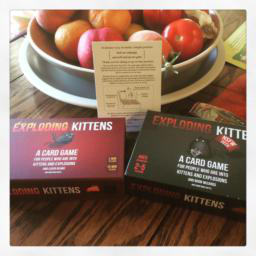
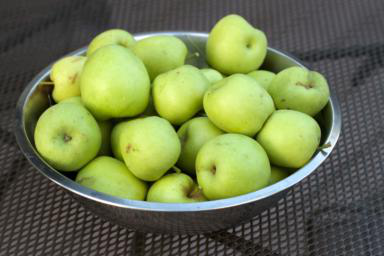
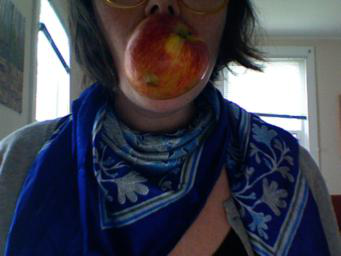
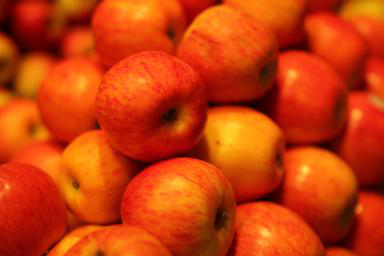
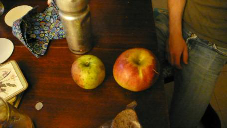
...
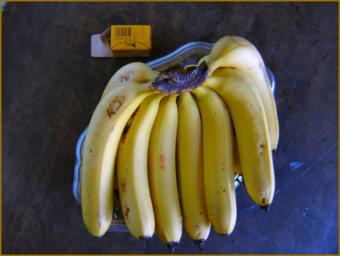
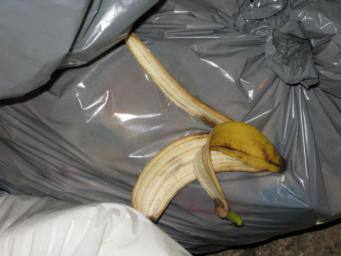
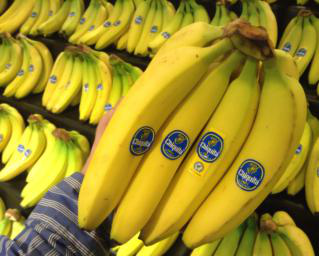
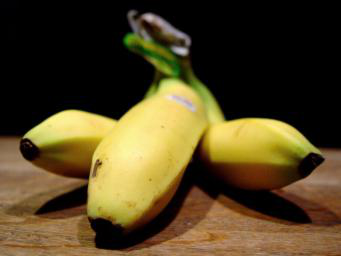
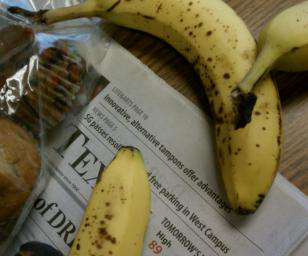

In [11]:
imgs_with_pred = test_data.add_columns(output) # test_data에 output columns을 추가한다.
imgs_with_pred.explore() # 새로 병합된 SFrame을 표시한다.

,path,image,label,class,probability
0,snacks/test/apple/03bfc0b1cc6bde63.jpg,,apple,orange,0.918046
1,snacks/test/apple/953a08e8cfa4dfce.jpg,,apple,grape,0.993543
2,snacks/test/banana/1ab26753f4930579.jpg,,banana,hot dog,0.901094
3,snacks/test/banana/33e2d11aef91defb.jpg,,banana,hot dog,0.996240
4,snacks/test/banana/84b93e935d419489.jpg,,banana,juice,0.951126
5,snacks/test/banana/89ed54d428adb296.jpg,,banana,hot dog,0.920749
6,snacks/test/cake/1c95483323464b46.jpg,,cake,muffin,0.987970
7,snacks/test/cake/ba0269590f729b08.jpg,,cake,hot dog,0.914839
8,snacks/test/candy/0f4aa7ed9302d084.jpg,,candy,strawberry,0.993067
9,snacks/test/candy/20d938b9cc57b4bd.jpg,,candy,strawberry,0.965466

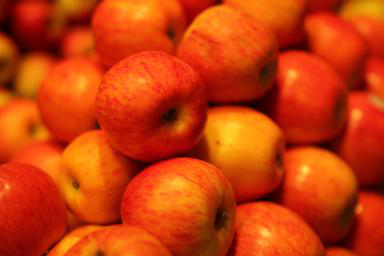
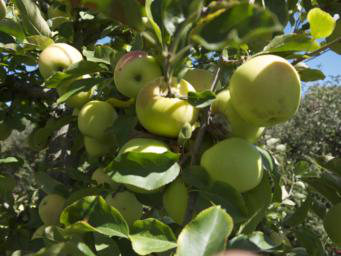
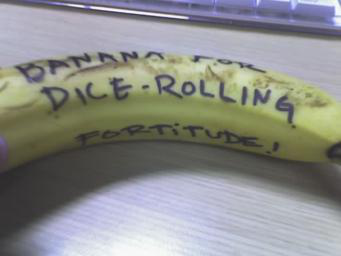
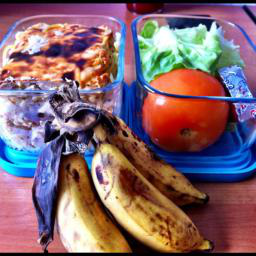
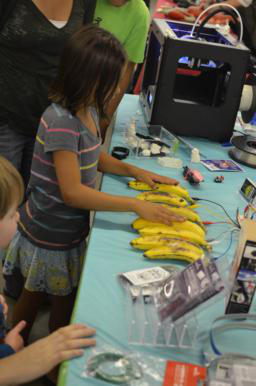
...
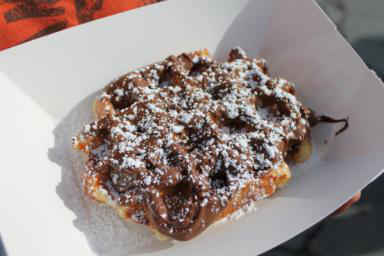
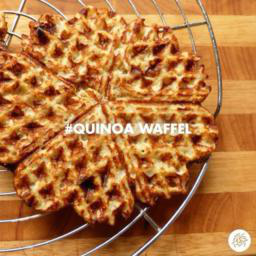
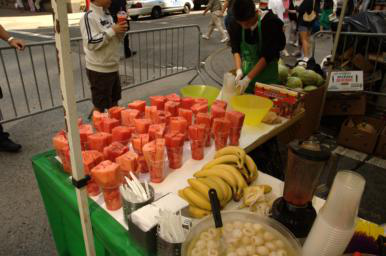
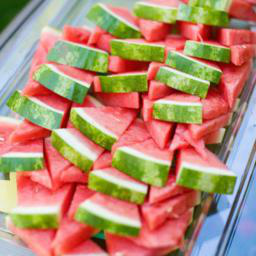
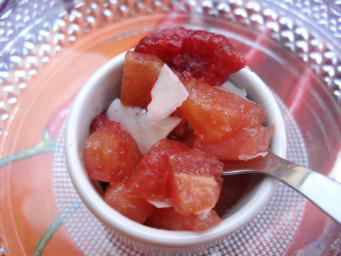

In [12]:
imgs_filtered = imgs_with_pred[(imgs_with_pred["probability"] > 0.9) & 
                               (imgs_with_pred["label"] != imgs_with_pred["class"] )]
# 확률이 90% 이상이면서 예측이 틀린 경우
imgs_filtered.explore()

In [13]:
predictions = model.predict(test_data, output_type="probability_vector")
# 매개변수 output_type을 추가하여 각 이미지의 확률 벡터(20개 class 에 대한 각각의 예측 확률)를 가져온다.

In [14]:
print("Probabilities for 2nd image", predictions[1]) # 모든 class 확률을 표시한다.

Probabilities for 2nd image array('d', [0.5664566526298075, 0.03828423011750032, 7.446610702550239e-06, 0.011587063501012297, 0.00018971739990694998, 0.001144780280931121, 7.539909949179365e-06, 0.07819623587433712, 8.691068007969028e-08, 1.669716118475001e-06, 1.1552834017199038e-05, 4.685882538540346e-08, 0.3006426605691418, 0.0029459187928786057, 3.324096281961664e-07, 1.203510623772482e-10, 8.942630057748331e-05, 3.496343157543093e-05, 9.797932136254242e-09, 0.0003996659341271171])


In [15]:
labels = test_data["label"].unique().sort()
# test_data SFrame에서 label 집합을 가져와 확률 벡터(probability vector)의 순서(order)와 일치하도록 정렬한 다음, 
# 결과를 Turi Create 배열(Array) SArray인 labels 변수에 저장한다. 
preds = tc.SArray(predictions[1])
# 두 번째 이미지의 확률 벡터(probability vector)에서 또 다른 SArray를 생성한다.
tc.SFrame({"preds": preds, "labels": labels}).sort([("preds", False)])
# 두 SArray를 SFrame로 병합한 다음 preds 열에서 내림차순(descending order)으로 정렬한다(오름차순(ascending) = True).

labels,preds
apple,0.5664566526298075
orange,0.3006426605691418
grape,0.07819623587433712
banana,0.03828423011750032
candy,0.011587063501012297
pineapple,0.0029459187928786057
cookie,0.001144780280931121
watermelon,0.0003996659341271171
carrot,0.00018971739990694998
salad,8.942630057748331e-05


In [16]:
val_data = tc.image_analysis.load_images("snacks/val", with_path=True)
val_data["label"] = val_data["path"].apply(lambda path:
                                           os.path.basename(os.path.split(path)[0])) 
len(val_data)
# 위에서와 같은 방식으로 이번에는 검증 이미지를 가져온다.

955

In [17]:
model = tc.image_classifier.create(train_data, target="label", 
                                   model="squeezenet_v1.1",
                                   verbose=True,
                                   max_iterations=100,
                                   validation_set=val_data)
# VisionFeaturePrint_Screen이 299x299 이미지에서 2,048개의 feature을 추출하는 것에 비해, 
# SqueezeNet은 227x227 pixel 이미지에서 1,000개의 feature만 추출하기 때문에 훨씬 빠르다.
# 하지만 정확도는 떨어진다.

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 992.124ms    | 1.25%            |

| 128              | 1.50s        | 2.5%             |

| 192              | 2.02s        | 3.75%            |

| 256              | 2.53s        | 5.25%            |

| 320              | 3.13s        | 6.5%             |

| 640              | 5.79s        | 13%              |

| 1280             | 11.03s       | 26.25%           |

| 1920             | 16.10s       | 39.25%           |

| 2560             | 21.66s       | 52.5%            |

| 3200             | 27.37s       | 65.75%           |

| 3840             | 33.24s       | 78.75%           |

| 4480             | 39.29s       | 92%              |

| 4838             | 42.89s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 1.06s        | 6.5%             |

| 128              | 1.56s        | 13.25%           |

| 192              | 2.07s        | 20%              |

| 256              | 2.60s        | 26.5%            |

| 320              | 3.18s        | 33.25%           |

| 640              | 6.12s        | 66.5%            |

| 955              | 9.10s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.906180     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 1.933286     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 2.445061     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 2.924613     | 0.272013          | 0.268063            |

| 4         | 10       | 1.250000  | 3.420172     | 0.241835          | 0.213613            |

| 9         | 17       | 1.000000  | 5.998744     | 0.446465          | 0.406283            |

| 14        | 22       | 1.000000  | 8.275871     | 0.479330          | 0.442932            |

| 19        | 29       | 1.000000  | 10.856618    | 0.571104          | 0.526702            |

| 24        | 34       | 1.000000  | 13.028971    | 0.602315          | 0.549738            |

| 29        | 41       | 1.000000  | 15.517461    | 0.624845          | 0.570681            |

| 34        | 47       | 1.000000  | 17.943558    | 0.652749          | 0.591623            |

| 39        | 54       | 0.398418  | 20.493068    | 0.675899          | 0.594764            |

| 44        | 61       | 0.778160  | 23.040487    | 0.683547          | 0.598953            |

| 49        | 66       | 1.000000  | 25.230442    | 0.704630          | 0.607330            |

| 54        | 75       | 1.000000  | 28.782025    | 0.720132          | 0.607330            |

| 59        | 85       | 0.638478  | 32.216250    | 0.726126          | 0.615707            |

| 64        | 91       | 1.000000  | 34.727095    | 0.735428          | 0.629319            |

| 69        | 106      | 1.234631  | 39.100116    | 0.745763          | 0.619895            |

| 74        | 112      | 1.000000  | 41.416110    | 0.755891          | 0.626178            |

| 79        | 118      | 1.000000  | 43.679436    | 0.763539          | 0.615707            |

| 84        | 125      | 1.000000  | 46.507998    | 0.769119          | 0.618848            |

| 89        | 131      | 1.000000  | 49.368723    | 0.782761          | 0.625131            |

| 94        | 140      | 0.612584  | 52.545401    | 0.788756          | 0.620942            |

| 99        | 147      | 0.547863  | 55.202513    | 0.796610          | 0.623037            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [18]:
model = tc.image_classifier.create(train_data, target="label", 
                                   model="squeezenet_v1.1",
                                   verbose=True,
                                   max_iterations=200, #max_iterations를 늘려 다시 학습한다.
                                   validation_set=val_data)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 1.12s        | 1.25%            |

| 128              | 1.63s        | 2.5%             |

| 192              | 2.14s        | 3.75%            |

| 256              | 2.64s        | 5.25%            |

| 320              | 3.26s        | 6.5%             |

| 640              | 5.89s        | 13%              |

| 1280             | 11.23s       | 26.25%           |

| 1920             | 17.01s       | 39.25%           |

| 2560             | 23.31s       | 52.5%            |

| 3200             | 29.84s       | 65.75%           |

| 3840             | 36.69s       | 78.75%           |

| 4480             | 45.10s       | 92%              |

| 4838             | 49.31s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 1.10s        | 6.5%             |

| 128              | 1.68s        | 13.25%           |

| 192              | 2.25s        | 20%              |

| 256              | 2.84s        | 26.5%            |

| 320              | 3.42s        | 33.25%           |

| 640              | 6.44s        | 66.5%            |

| 955              | 9.63s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.966578     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 2.036875     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 2.518901     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 2.963256     | 0.272013          | 0.268063            |

| 4         | 10       | 1.250000  | 3.483950     | 0.241835          | 0.213613            |

| 9         | 17       | 1.000000  | 7.854802     | 0.446465          | 0.406283            |

| 14        | 22       | 1.000000  | 10.288008    | 0.479330          | 0.442932            |

| 19        | 29       | 1.000000  | 13.490172    | 0.571104          | 0.526702            |

| 24        | 34       | 1.000000  | 16.477450    | 0.602315          | 0.549738            |

| 29        | 41       | 1.000000  | 19.225087    | 0.624845          | 0.570681            |

| 34        | 47       | 1.000000  | 21.722203    | 0.652749          | 0.591623            |

| 39        | 54       | 0.398418  | 25.621011    | 0.675899          | 0.594764            |

| 44        | 61       | 0.778160  | 28.604433    | 0.683547          | 0.598953            |

| 49        | 66       | 1.000000  | 32.053936    | 0.704630          | 0.607330            |

| 54        | 75       | 1.000000  | 35.383985    | 0.720132          | 0.607330            |

| 59        | 85       | 0.638478  | 39.513934    | 0.726126          | 0.615707            |

| 64        | 91       | 1.000000  | 42.452474    | 0.735428          | 0.629319            |

| 69        | 106      | 1.234631  | 47.073981    | 0.745763          | 0.619895            |

| 74        | 112      | 1.000000  | 50.968731    | 0.755891          | 0.626178            |

| 79        | 118      | 1.000000  | 55.169467    | 0.763539          | 0.615707            |

| 84        | 125      | 1.000000  | 58.341817    | 0.769119          | 0.618848            |

| 89        | 131      | 1.000000  | 62.220981    | 0.782761          | 0.625131            |

| 94        | 140      | 0.612584  | 65.589913    | 0.788756          | 0.620942            |

| 99        | 147      | 0.547863  | 68.585079    | 0.796610          | 0.623037            |

| 104       | 153      | 1.000000  | 72.092073    | 0.804258          | 0.624084            |

| 109       | 159      | 1.000000  | 75.190383    | 0.815420          | 0.631414            |

| 114       | 166      | 1.000000  | 81.786849    | 0.820380          | 0.631414            |

| 119       | 173      | 1.000000  | 89.520014    | 0.831542          | 0.628272            |

| 124       | 179      | 0.961534  | 95.560094    | 0.837743          | 0.633508            |

| 129       | 184      | 1.000000  | 99.853176    | 0.837536          | 0.633508            |

| 134       | 197      | 1.419725  | 106.705721   | 0.854485          | 0.640838            |

| 139       | 205      | 1.000000  | 111.096057   | 0.859033          | 0.645026            |

| 144       | 212      | 1.000000  | 115.337176   | 0.869574          | 0.632461            |

| 149       | 217      | 1.000000  | 118.951011   | 0.870401          | 0.635602            |

| 154       | 222      | 1.000000  | 121.920475   | 0.878049          | 0.630366            |

| 159       | 228      | 1.000000  | 124.804019   | 0.878876          | 0.630366            |

| 164       | 234      | 1.000000  | 127.771456   | 0.885903          | 0.632461            |

| 169       | 240      | 1.000000  | 130.619932   | 0.887764          | 0.635602            |

| 174       | 247      | 1.000000  | 135.273161   | 0.897272          | 0.631414            |

| 179       | 252      | 1.000000  | 138.848864   | 0.898925          | 0.620942            |

| 184       | 258      | 1.000000  | 141.380994   | 0.905333          | 0.623037            |

| 189       | 264      | 1.000000  | 143.932258   | 0.912360          | 0.619895            |

| 194       | 270      | 1.000000  | 148.101193   | 0.919388          | 0.615707            |

| 199       | 275      | 1.000000  | 151.963854   | 0.920835          | 0.616754            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [19]:
metrics = model.evaluate(test_data) 
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])
# 모델을 평가하고 분석 결과를 표시한다.

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 1.89s        | 6.5%             |

| 128              | 2.45s        | 13.25%           |

| 192              | 2.99s        | 20%              |

| 256              | 3.57s        | 26.5%            |

| 320              | 4.12s        | 33.25%           |

| 640              | 7.42s        | 66.5%            |

| 952              | 10.17s       | 100%             |

+------------------+--------------+------------------+

/Users/geunseong-gai/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


Accuracy:  0.6355042016806722
Precision:  0.6367240202604002
Recall:  0.6313409863945578


In [20]:
print("Confusion Matrix:\n", metrics["confusion_matrix"])
# 분류 결과표를 출력한다.

Confusion Matrix:
 +--------------+-----------------+-------+
| target_label | predicted_label | count |
+--------------+-----------------+-------+
|     cake     |       cake      |   27  |
|  strawberry  |    watermelon   |   3   |
|    candy     |      candy      |   27  |
|    grape     |      salad      |   1   |
|    cookie    |       cake      |   1   |
|    banana    |      banana     |   35  |
|    muffin    |     doughnut    |   6   |
|    juice     |       cake      |   1   |
|    carrot    |    strawberry   |   1   |
|     cake     |      muffin     |   4   |
+--------------+-----------------+-------+
[217 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


In [21]:
import numpy as np
import seaborn as sns

def compute_confusion_matrix(metrics, labels):
    num_labels = len(labels) # 레이블 수
    label_to_index = {l:i for i,l in enumerate(labels)}
    
    conf = np.zeros((num_labels, num_labels), dtype=np.int)
    for row in metrics["confusion_matrix"]:
        true_label = label_to_index[row["target_label"]] 
        pred_label = label_to_index[row["predicted_label"]] 
        conf[true_label, pred_label] = row["count"]
        # 모든 행을 살펴보고, 각 레이블 쌍의 개수로 2D 배열을 채운다.
        
    return conf

def plot_confusion_matrix(conf, labels, figsize=(8, 8)): # 결과를 가져와 히트맵을 그린다.
    fig = plt.figure(figsize=figsize)
    heatmap = sns.heatmap(conf, annot=True, fmt="d")
    heatmap.xaxis.set_ticklabels(labels, rotation=45, ha="right", fontsize=12)
    heatmap.yaxis.set_ticklabels(labels, rotation=0, ha="right", fontsize=12)
    plt.xlabel("Predicted label", fontsize=12)
    plt.ylabel("True label", fontsize=12)
    plt.show()

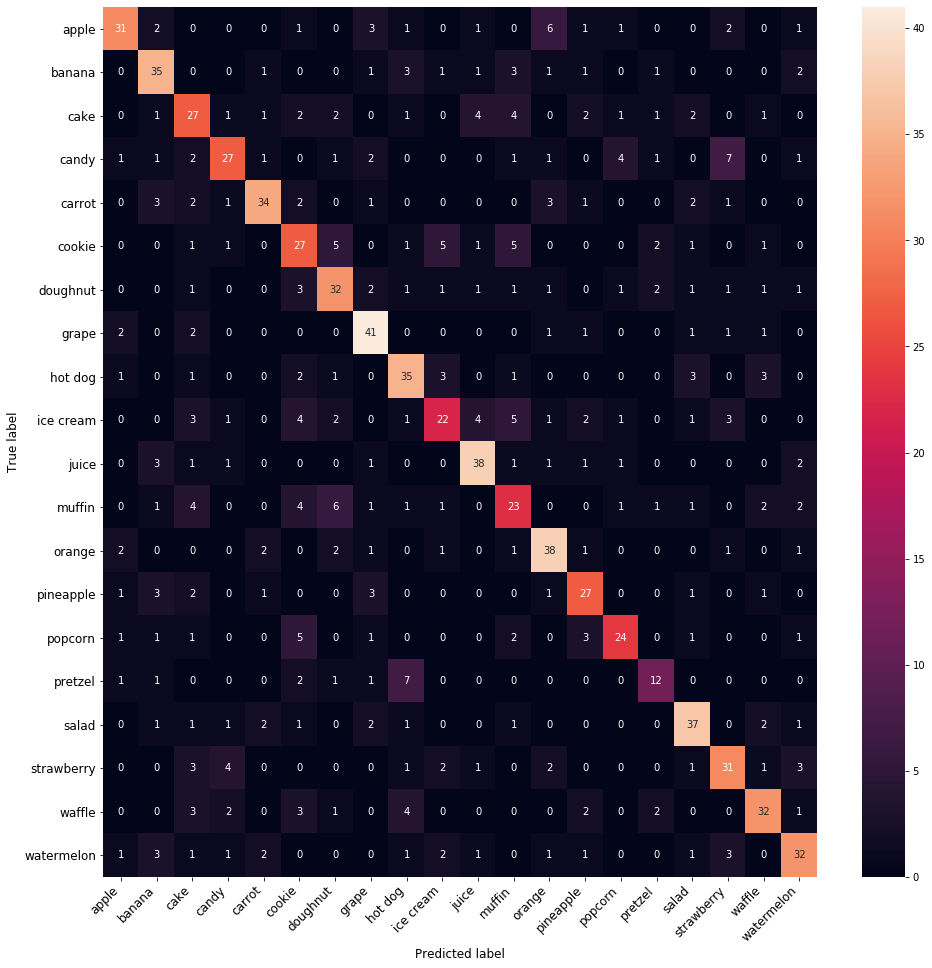

In [22]:
conf = compute_confusion_matrix(metrics, labels) 
plot_confusion_matrix(conf, labels, figsize=(16, 16))
# 함수 호출

In [24]:
for i, label in enumerate(labels):
    correct = conf[i, i]
    images_per_class = conf[i].sum()
    print("%10s %.1f%%" % (label, 100. * correct/images_per_class))
    
# 각 클래스의 정확도를 얻는다. 이것이 재현율(recall)이 된다.

     apple 62.0%
    banana 70.0%
      cake 54.0%
     candy 54.0%
    carrot 68.0%
    cookie 54.0%
  doughnut 64.0%
     grape 82.0%
   hot dog 70.0%
 ice cream 44.0%
     juice 76.0%
    muffin 47.9%
    orange 76.0%
 pineapple 67.5%
   popcorn 60.0%
   pretzel 48.0%
     salad 74.0%
strawberry 63.3%
    waffle 64.0%
watermelon 64.0%


In [26]:
model = tc.image_classifier.create(train_data, 
                                   target="label", 
                                   model="squeezenet_v1.1",
                                   verbose=True,
                                   max_iterations=200,
                                   validation_set=val_data,
                                   l2_penalty=10.0,
                                   l1_penalty=0.0,
                                   convergence_threshold=1e-8)
# 정규화한다. 정규화는 과적합을 방지하는 데 도움이 된다.
# convergence_threshold를 매우 작은 값으로 설정하면 200번의 반복이 모두 완료될 때까지, 교육이 중단되지 않는다.
# l2_penalty와 l1_penalty는 과적합을 줄이기 위해 정규화를 추가하는 하이퍼 파라미터이다.

Downloading base mlmodel

Downloading https://docs-assets.developer.apple.com/coreml/models/SqueezeNet.mlmodel to /var/folders/44/ftc9j45j0j51fjlch9sxln080000gn/T/model_cache/squeezenet_v1.1.mlmodel

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 972.771ms    | 1.25%            |

| 128              | 1.49s        | 2.5%             |

| 192              | 2.03s        | 3.75%            |

| 256              | 2.54s        | 5.25%            |

| 320              | 3.06s        | 6.5%             |

| 640              | 5.67s        | 13%              |

| 1280             | 10.88s       | 26.25%           |

| 1920             | 16.44s       | 39.25%           |

| 2560             | 22.55s       | 52.5%            |

| 3200             | 28.85s       | 65.75%           |

| 3840             | 35.06s       | 78.75%           |

| 4480             | 41.51s       | 92%              |

| 4838             | 45.36s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 1.14s        | 6.5%             |

| 128              | 1.68s        | 13.25%           |

| 192              | 2.24s        | 20%              |

| 256              | 2.85s        | 26.5%            |

| 320              | 3.43s        | 33.25%           |

| 640              | 6.61s        | 66.5%            |

| 955              | 9.71s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.986768     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 2.063919     | 0.295163          | 0.273298            |

| 2         | 8        | 1.250000  | 2.607772     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 3.228262     | 0.272427          | 0.268063            |

| 4         | 10       | 1.250000  | 3.825011     | 0.243282          | 0.215707            |

| 9         | 17       | 1.000000  | 7.254135     | 0.446672          | 0.406283            |

| 14        | 23       | 1.000000  | 10.899732    | 0.475196          | 0.446073            |

| 19        | 30       | 1.000000  | 15.485289    | 0.573377          | 0.530890            |

| 24        | 35       | 1.000000  | 18.457808    | 0.600248          | 0.553927            |

| 29        | 41       | 1.000000  | 21.386875    | 0.623191          | 0.568586            |

| 34        | 52       | 3.906086  | 26.316310    | 0.654816          | 0.593717            |

| 39        | 59       | 1.000000  | 31.181938    | 0.674246          | 0.598953            |

| 44        | 68       | 0.976543  | 36.391919    | 0.692848          | 0.606283            |

| 49        | 73       | 1.000000  | 40.192878    | 0.700703          | 0.601047            |

| 54        | 79       | 1.000000  | 44.020039    | 0.709384          | 0.623037            |

| 59        | 84       | 1.000000  | 46.784036    | 0.721166          | 0.628272            |

| 64        | 89       | 1.000000  | 50.237694    | 0.729020          | 0.631414            |

| 69        | 96       | 1.000000  | 54.118271    | 0.740389          | 0.638743            |

| 74        | 102      | 1.000000  | 58.946286    | 0.744936          | 0.631414            |

| 79        | 108      | 1.000000  | 62.494124    | 0.752584          | 0.634555            |

| 84        | 114      | 1.000000  | 66.060864    | 0.759405          | 0.640838            |

| 89        | 119      | 1.000000  | 70.114263    | 0.766019          | 0.645026            |

| 94        | 125      | 1.000000  | 73.558350    | 0.766019          | 0.634555            |

| 99        | 132      | 1.000000  | 77.383072    | 0.768499          | 0.639791            |

| 104       | 138      | 1.000000  | 81.665885    | 0.770360          | 0.646073            |

| 109       | 145      | 0.842977  | 86.787698    | 0.772427          | 0.645026            |

| 114       | 151      | 1.000000  | 89.569932    | 0.779248          | 0.640838            |

| 119       | 156      | 1.000000  | 92.220067    | 0.781728          | 0.641885            |

| 124       | 173      | 1.792901  | 97.726341    | 0.784415          | 0.643979            |

| 129       | 182      | 1.000000  | 102.324750   | 0.786069          | 0.641885            |

| 134       | 188      | 1.000000  | 106.205478   | 0.787309          | 0.645026            |

| 139       | 195      | 1.000000  | 109.610847   | 0.788756          | 0.648168            |

| 144       | 208      | 1.433791  | 114.150146   | 0.787722          | 0.650262            |

| 149       | 215      | 0.528661  | 117.949079   | 0.787516          | 0.650262            |

| 154       | 221      | 1.000000  | 121.665031   | 0.787722          | 0.648168            |

| 159       | 227      | 1.000000  | 125.067208   | 0.787929          | 0.649215            |

| 164       | 239      | 4.524384  | 131.040844   | 0.788756          | 0.649215            |

| 169       | 247      | 1.000000  | 135.223490   | 0.787722          | 0.648168            |

| 174       | 256      | 1.000000  | 139.461665   | 0.788549          | 0.648168            |

| 179       | 263      | 0.922707  | 143.588547   | 0.786275          | 0.648168            |

| 184       | 269      | 1.000000  | 146.961360   | 0.787929          | 0.650262            |

| 189       | 278      | 1.000000  | 151.584127   | 0.788962          | 0.650262            |

| 194       | 287      | 1.000000  | 155.866714   | 0.787722          | 0.650262            |

| 199       | 294      | 1.000000  | 160.769300   | 0.787929          | 0.651309            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [27]:
from turicreate.toolkits import _pre_trained_models
from turicreate.toolkits import _image_feature_extractor

ptModel = _pre_trained_models.MODELS["squeezenet_v1.1"]()
feature_extractor = _image_feature_extractor.MXFeatureExtractor(ptModel)
# 사전 훈련된 몯[ㄹ을 불러온다.

Download completed: /var/folders/44/ftc9j45j0j51fjlch9sxln080000gn/T/model_cache/squeezenet_v1.1-symbol.json
Download completed: /var/folders/44/ftc9j45j0j51fjlch9sxln080000gn/T/model_cache/squeezenet_v1.1-0000.params


In [28]:
 train_features = feature_extractor.extract_features(train_data, "image", verbose=True)

Performing feature extraction on resized images...
Completed   64/4838
Completed  128/4838
Completed  192/4838
Completed  256/4838
Completed  320/4838
Completed  384/4838
Completed  448/4838
Completed  512/4838
Completed  576/4838
Completed  640/4838
Completed  704/4838
Completed  768/4838
Completed  832/4838
Completed  896/4838
Completed  960/4838
Completed 1024/4838
Completed 1088/4838
Completed 1152/4838
Completed 1216/4838
Completed 1280/4838
Completed 1344/4838
Completed 1408/4838
Completed 1472/4838
Completed 1536/4838
Completed 1600/4838
Completed 1664/4838
Completed 1728/4838
Completed 1792/4838
Completed 1856/4838
Completed 1920/4838
Completed 1984/4838
Completed 2048/4838
Completed 2112/4838
Completed 2176/4838
Completed 2240/4838
Completed 2304/4838
Completed 2368/4838
Completed 2432/4838
Completed 2496/4838
Completed 2560/4838
Completed 2624/4838
Completed 2688/4838
Completed 2752/4838
Completed 2816/4838
Completed 2880/4838
Completed 2944/4838
Completed 3008/4838
Completed

In [29]:
extracted_train_features = tc.SFrame({ 
    "label": train_data["label"], 
    "__image_features__": train_features, 
})

In [30]:
extracted_train_features.save("extracted_train_features.sframe") # 저장

In [ ]:
# Run this tomorrow or next week
extracted_train_features = tc.SFrame("extracted_train_features.sframe")

In [31]:
extracted_train_features.head()

__image_features__,label
"[6.133736610412598,10.128445625305176, ...",apple
"[9.667001724243164,14.66533088684082, ...",apple
"[10.662522315979004,15.472965240478516, ...",apple
"[12.159001350402832,11.231391906738281, ...",apple
"[17.97437286376953,19.08957290649414, ...",apple
"[5.879779815673828,9.116368293762207, ...",apple
"[6.748987197875977,6.330109596252441, ...",apple
"[5.711241245269775,13.054987907409668, ...",apple
"[8.625850677490234,6.533731937408447, ...",apple
"[6.44061279296875,13.472396850585938, ...",apple


In [32]:
extracted_train_features[0]["__image_features__"] #특징 벡터를 이해할 수는 없지만, 특정한 값들이 저장된다.

array('d', [6.133736610412598, 10.128445625305176, 13.02511215209961, 7.931195259094238, 12.038104057312012, 15.103206634521484, 12.72289752960205, 10.93090534210205, 12.778319358825684, 14.20803451538086, 16.8399715423584, 11.781682014465332, 18.99500274658203, 17.461009979248047, 18.71086883544922, 12.680944442749023, 13.507372856140137, 11.648835182189941, 12.983748435974121, 10.726638793945312, 14.919912338256836, 12.129714012145996, 11.41422176361084, 14.733704566955566, 9.810266494750977, 10.89663028717041, 18.01943588256836, 15.979007720947266, 13.082320213317871, 13.183862686157227, 9.810114860534668, 12.890341758728027, 17.385116577148438, 12.061917304992676, 12.310940742492676, 12.094202995300293, 14.050444602966309, 13.809377670288086, 18.275421142578125, 16.623281478881836, 17.035625457763672, 22.040359497070312, 16.95296287536621, 13.085404396057129, 20.951557159423828, 13.966252326965332, 16.579864501953125, 16.847400665283203, 14.338922500610352, 16.345020294189453, 13.9

In [33]:
val_features = feature_extractor.extract_features(val_data, "image", verbose=True)
extracted_val_features = tc.SFrame({ 
    "label": val_data["label"], 
    '__image_features__': val_features,
})
extracted_val_features.save("extracted_val_features.sframe")

Performing feature extraction on resized images...
Completed  64/955
Completed 128/955
Completed 192/955
Completed 256/955
Completed 320/955
Completed 384/955
Completed 448/955
Completed 512/955
Completed 576/955
Completed 640/955
Completed 704/955
Completed 768/955
Completed 832/955
Completed 896/955
Completed 955/955


In [34]:
lr_model = tc.logistic_classifier.create(extracted_train_features,
                                         features=["__image_features__"], 
                                         target="label",
                                         validation_set=extracted_val_features,
                                         max_iterations=200,
                                         seed=None,
                                         verbose=True,
                                         l2_penalty=10.0,
                                         l1_penalty=0.0,
                                         convergence_threshold=1e-8)

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 1.145411     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 2.443429     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 3.169332     | 0.139314          | 0.150785            |

| 3         | 9        | 1.250000  | 4.009539     | 0.272220          | 0.268063            |

| 4         | 10       | 1.250000  | 5.111248     | 0.243696          | 0.215707            |

| 9         | 17       | 1.000000  | 10.807016    | 0.447499          | 0.406283            |

| 14        | 23       | 1.000000  | 15.447885    | 0.475196          | 0.445026            |

| 19        | 30       | 1.000000  | 19.612400    | 0.573171          | 0.530890            |

| 24        | 35       | 1.000000  | 23.184101    | 0.600248          | 0.553927            |

| 29        | 41       | 1.000000  | 27.140131    | 0.622985          | 0.568586            |

| 34        | 52       | 3.942587  | 32.319328    | 0.656470          | 0.593717            |

| 39        | 58       | 1.000000  | 35.566868    | 0.674452          | 0.597906            |

| 44        | 67       | 1.000000  | 40.477064    | 0.693468          | 0.606283            |

| 49        | 74       | 1.000000  | 44.851765    | 0.704217          | 0.607330            |

| 54        | 81       | 1.000000  | 48.527790    | 0.708351          | 0.625131            |

| 59        | 87       | 1.000000  | 51.885544    | 0.718065          | 0.626178            |

| 64        | 93       | 1.000000  | 55.826557    | 0.725506          | 0.627225            |

| 69        | 98       | 1.000000  | 60.194137    | 0.738942          | 0.632461            |

| 74        | 106      | 0.803579  | 66.185619    | 0.744316          | 0.632461            |

| 79        | 112      | 1.000000  | 71.060811    | 0.749897          | 0.636649            |

| 84        | 118      | 1.000000  | 75.181609    | 0.752377          | 0.639791            |

| 89        | 131      | 1.036695  | 82.116027    | 0.764779          | 0.646073            |

| 94        | 137      | 1.000000  | 85.892931    | 0.764986          | 0.646073            |

| 99        | 145      | 1.000000  | 89.543653    | 0.768706          | 0.642932            |

| 104       | 152      | 1.000000  | 93.090397    | 0.767259          | 0.643979            |

| 109       | 158      | 1.000000  | 96.244298    | 0.771600          | 0.648168            |

| 114       | 168      | 0.857525  | 101.263555   | 0.774907          | 0.649215            |

| 119       | 174      | 0.745164  | 104.770782   | 0.775734          | 0.643979            |

| 124       | 179      | 1.000000  | 108.264147   | 0.776974          | 0.643979            |

| 129       | 185      | 1.000000  | 111.542936   | 0.780074          | 0.642932            |

| 134       | 193      | 0.503445  | 115.115179   | 0.781935          | 0.645026            |

| 139       | 203      | 0.616897  | 119.849041   | 0.781521          | 0.645026            |

| 144       | 209      | 1.000000  | 123.682142   | 0.785242          | 0.643979            |

| 149       | 215      | 1.000000  | 127.399604   | 0.785242          | 0.646073            |

| 154       | 223      | 0.857793  | 131.902464   | 0.788342          | 0.649215            |

| 159       | 237      | 1.677140  | 138.429791   | 0.787309          | 0.649215            |

| 164       | 243      | 1.039851  | 141.662910   | 0.787929          | 0.649215            |

| 169       | 248      | 1.039851  | 145.288616   | 0.787929          | 0.649215            |

| 174       | 263      | 1.000000  | 152.234898   | 0.789376          | 0.649215            |

| 179       | 275      | 1.921463  | 158.359756   | 0.791029          | 0.648168            |

| 184       | 287      | 0.532220  | 164.227765   | 0.790203          | 0.649215            |

| 189       | 295      | 0.500000  | 169.375759   | 0.788756          | 0.649215            |

| 194       | 308      | 0.731299  | 175.748280   | 0.787929          | 0.649215            |

| 199       | 320      | 0.789185  | 181.633014   | 0.788342          | 0.650262            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [35]:
tc.logistic_classifier.create?

In [36]:
from turicreate.toolkits.image_classifier import ImageClassifier

state = {
    'classifier': lr_model,
    'model': ptModel.name,
    'max_iterations': lr_model.max_iterations, 
    'feature_extractor': feature_extractor, 
    'input_image_shape': ptModel.input_image_shape, 
    'target': lr_model.target,
    'feature': "image",
    'num_features': 1,
    'num_classes': lr_model.num_classes,
    'classes': lr_model.classes,
    'num_examples': lr_model.num_examples, 
    'training_time': lr_model.training_time, 
    'training_loss': lr_model.training_loss,
}

model = ImageClassifier(state)
# 기본 모델과 훈련시킨 분류기를 state structure로 결합해서, ImageClassifier 객체를 만든다.

In [37]:
metrics = model.evaluate(test_data) 
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])

Performing feature extraction on resized images...
Completed  64/952
Completed 128/952
Completed 192/952
Completed 256/952
Completed 320/952
Completed 384/952
Completed 448/952
Completed 512/952
Completed 576/952
Completed 640/952
Completed 704/952
Completed 768/952
Completed 832/952
Completed 896/952
Completed 952/952


/Users/geunseong-gai/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


Accuracy:  0.6691176470588235
Precision:  0.6720308280105255
Recall:  0.6672984693877552


In [38]:
model.save("MultiSnacks_regularized.model") # Turi Create 로 저장

In [39]:
model.export_coreml("MultiSnacks_regularized.mlmodel") # Core ML 로 저장

In [40]:
model

Class                                    : ImageClassifier

Schema
------
Number of classes                        : 20
Number of feature columns                : 1
Input image shape                        : (3, 227, 227)

Training summary
----------------
Number of examples                       : 4838
Training loss                            : 3952.7851
Training time (sec)                      : 99.4526

In [41]:
model.classifier

Class                          : LogisticClassifier

Schema
------
Number of coefficients         : 19019
Number of examples             : 4838
Number of classes              : 20
Number of feature columns      : 1
Number of unpacked features    : 1000

Hyperparameters
---------------
L1 penalty                     : 0.0
L2 penalty                     : 10.0

Training Summary
----------------
Solver                         : lbfgs
Solver iterations              : 200
Solver status                  : Completed (Iteration limit reached).
Training time (sec)            : 99.4526

Settings
--------
Log-likelihood                 : 3952.7851

Highest Positive Coefficients
-----------------------------
(intercept)                    : 0.4049
(intercept)                    : 0.2768
(intercept)                    : 0.1472
(intercept)                    : 0.0998
(intercept)                    : 0.0908

Lowest Negative Coefficients
----------------------------
(intercept)                    : -0

In [42]:
no_reg_model = tc.load_model("MultiSnacks.model") 
no_reg_model.classifier
# 미리 훈련된 모델을 다시 불러온다.

Class                          : LogisticClassifier

Schema
------
Number of coefficients         : 19019
Number of examples             : 4606
Number of classes              : 20
Number of feature columns      : 1
Number of unpacked features    : 1000

Hyperparameters
---------------
L1 penalty                     : 0.0
L2 penalty                     : 0.01

Training Summary
----------------
Solver                         : lbfgs
Solver iterations              : 135
Solver status                  : Completed (Iteration limit reached).
Training time (sec)            : 69.3918

Settings
--------
Log-likelihood                 : 2400.3284

Highest Positive Coefficients
-----------------------------
(intercept)                    : 0.3808
(intercept)                    : 0.3799
(intercept)                    : 0.1918
__image_features__[839]        : 0.1864
(intercept)                    : 0.15

Lowest Negative Coefficients
----------------------------
(intercept)                    : -0.3